In [1]:
!pip install folium

In [2]:
import pandas as pd
import geopandas as gpd
import folium
from shapely.geometry import Point
import numpy as np
import matplotlib.pyplot as plt
import shapely as shp
import plotly.graph_objects as go


In [3]:
print(gpd.__version__)

0.14.3


In [4]:
ruta_ideam = 'dataset/Datos_de_Estaciones_de_IDEAM_y_de_Terceros_20240525.csv'
ruta_municipios = 'dataset/municipios.geojson'

In [5]:
df = pd.read_csv(ruta_ideam)

In [6]:
df.head()

,CodigoEstacion,CodigoSensor,FechaObservacion,ValorObservado,NombreEstacion,Departamento,Municipio,ZonaHidrografica,Latitud,Longitud,DescripcionSensor,UnidadMedida,Entidad
0,26125061,111,05/22/2024 08:06:00 PM,1.7,AEROPUERTO EL EDEN -,QUINDÍO,ARMENIA,CAUCA,4.454722,-75.766389,GPRS - VELOCIDAD DEL VIENTO,m/s,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
1,2403000117,28,05/22/2024 08:08:00 PM,78.0,PM LA LAGUNA,BOYACÁ,GUACAMAYAS,SOGAMOSO,6.447167,-72.497694,GPRS - HUMEDAD DEL AIRE A 2 m,%,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
2,3502500135,28,05/22/2024 09:46:00 PM,100.0,GUAYABETAL POLLO OLIMPICO,CUNDINAMARCA,GUAYABETAL,META,4.225530,-73.814810,GPRS - HUMEDAD DEL AIRE A 2 m,%,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
3,52055230,111,05/22/2024 08:04:00 PM,1.5,AEROPUERTO SAN LUIS,NARIÑO,ALDANA,PATÍA,0.857083,-77.677750,GPRS - VELOCIDAD DEL VIENTO,m/s,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
4,2403000117,71,05/23/2024 02:20:00 AM,12.3,PM LA LAGUNA,BOYACÁ,GUACAMAYAS,SOGAMOSO,6.447167,-72.497694,GPRS - TEMPERATURA DEL AIRE A 2 m,°C,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...


In [7]:
df_coords = df[['Latitud', 'Longitud']]

In [8]:
# Crear una geometría de puntos a partir de las coordenadas
geometry = [Point(xy) for xy in zip(df_coords['Longitud'], df_coords['Latitud'])]

# Crear un GeoDataFrame
gdf = gpd.GeoDataFrame(df_coords, geometry=geometry)

# Definir el sistema de referencia de coordenadas (CRS)
gdf.crs = {'init': 'epsg:4326'}

/opt/conda/lib/python3.11/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [9]:
# Crear un mapa centrado en la primera coordenada del GeoDataFrame
m = folium.Map(location=[df_coords.iloc[0]['Latitud'], df_coords.iloc[0]['Longitud']], zoom_start=12)

# Agregar puntos al mapa
for idx, row in gdf.iterrows():
    folium.Marker([row['Latitud'], row['Longitud']]).add_to(m)

# Mostrar el mapa
m

In [6]:
ideam = gpd.read_file(ruta_ideam)
municipios = gpd.read_file(ruta_municipios)

In [5]:
print(ideam.shape)
ideam.info()

(97467, 14)
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 97467 entries, 0 to 97466
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   CodigoEstacion     97467 non-null  object  
 1   CodigoSensor       97467 non-null  object  
 2   FechaObservacion   97467 non-null  object  
 3   ValorObservado     97467 non-null  object  
 4   NombreEstacion     97467 non-null  object  
 5   Departamento       97467 non-null  object  
 6   Municipio          97467 non-null  object  
 7   ZonaHidrografica   97467 non-null  object  
 8   Latitud            97467 non-null  object  
 9   Longitud           97467 non-null  object  
 10  DescripcionSensor  97467 non-null  object  
 11  UnidadMedida       97467 non-null  object  
 12  Entidad            97467 non-null  object  
 13  geometry           0 non-null      geometry
dtypes: geometry(1), object(13)
memory usage: 10.4+ MB


In [6]:
ideam.isnull().sum()

CodigoEstacion           0
CodigoSensor             0
FechaObservacion         0
ValorObservado           0
NombreEstacion           0
Departamento             0
Municipio                0
ZonaHidrografica         0
Latitud                  0
Longitud                 0
DescripcionSensor        0
UnidadMedida             0
Entidad                  0
geometry             97467
dtype: int64

In [7]:
ideam.describe()

,CodigoEstacion,CodigoSensor,FechaObservacion,ValorObservado,NombreEstacion,Departamento,Municipio,ZonaHidrografica,Latitud,Longitud,DescripcionSensor,UnidadMedida,Entidad,geometry
count,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,0
unique,202,17,2868,7200,199,29,108,24,201,201,17,9,6,0
top,3502500135,0240,05/23/2024 02:00:00 AM,0,GUAYABETAL POLLO OLIMPICO,CUNDINAMARCA,BOGOTA D.C,ALTO MAGDALENA,4.22553,-73.81481,PRECIPITACIÓN,mm,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...,NaN
freq,4411,22720,535,31461,4411,11415,9574,17409,4411,4411,22720,32784,84783,NaN


In [8]:
ideam.describe([0.01, 0.05, 0.75, 0.90, 0.99]).T

,count,unique,top,freq
CodigoEstacion,97467,202,3502500135,4411
CodigoSensor,97467,17,0240,22720
FechaObservacion,97467,2868,05/23/2024 02:00:00 AM,535
ValorObservado,97467,7200,0,31461
NombreEstacion,97467,199,GUAYABETAL POLLO OLIMPICO,4411
Departamento,97467,29,CUNDINAMARCA,11415
Municipio,97467,108,BOGOTA D.C,9574
ZonaHidrografica,97467,24,ALTO MAGDALENA,17409
Latitud,97467,201,4.22553,4411
Longitud,97467,201,-73.81481,4411


In [12]:
df = ideam.drop(columns=['geometry'])

In [13]:
df.describe()

,CodigoEstacion,CodigoSensor,FechaObservacion,ValorObservado,NombreEstacion,Departamento,Municipio,ZonaHidrografica,Latitud,Longitud,DescripcionSensor,UnidadMedida,Entidad
count,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467,97467
unique,202,17,2868,7200,199,29,108,24,201,201,17,9,6
top,3502500135,0240,05/23/2024 02:00:00 AM,0,GUAYABETAL POLLO OLIMPICO,CUNDINAMARCA,BOGOTA D.C,ALTO MAGDALENA,4.22553,-73.81481,PRECIPITACIÓN,mm,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
freq,4411,22720,535,31461,4411,11415,9574,17409,4411,4411,22720,32784,84783


In [15]:
df[['CodigoEstacion','CodigoSensor','FechaObservacion','ValorObservado','NombreEstacion','Departamento','Municipio','UnidadMedida','DescripcionSensor']] = df[['CodigoEstacion','CodigoSensor','FechaObservacion','ValorObservado','NombreEstacion','Departamento','Municipio','UnidadMedida','DescripcionSensor']].replace(0,np.NaN)
df.head()

,CodigoEstacion,CodigoSensor,FechaObservacion,ValorObservado,NombreEstacion,Departamento,Municipio,ZonaHidrografica,Latitud,Longitud,DescripcionSensor,UnidadMedida,Entidad
0,0026125061,0111,05/22/2024 08:06:00 PM,1.7,AEROPUERTO EL EDEN -,QUINDÍO,ARMENIA,CAUCA,4.45472222,-75.76638889,GPRS - VELOCIDAD DEL VIENTO,m/s,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
1,2403000117,0028,05/22/2024 08:08:00 PM,78,PM LA LAGUNA,BOYACÁ,GUACAMAYAS,SOGAMOSO,6.44716667,-72.49769444,GPRS - HUMEDAD DEL AIRE A 2 m,%,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
2,3502500135,0028,05/22/2024 09:46:00 PM,100,GUAYABETAL POLLO OLIMPICO,CUNDINAMARCA,GUAYABETAL,META,4.22553,-73.81481,GPRS - HUMEDAD DEL AIRE A 2 m,%,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
3,0052055230,0111,05/22/2024 08:04:00 PM,1.5,AEROPUERTO SAN LUIS,NARIÑO,ALDANA,PATÍA,0.85708333,-77.67775,GPRS - VELOCIDAD DEL VIENTO,m/s,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...
4,2403000117,0071,05/23/2024 02:20:00 AM,12.3,PM LA LAGUNA,BOYACÁ,GUACAMAYAS,SOGAMOSO,6.44716667,-72.49769444,GPRS - TEMPERATURA DEL AIRE A 2 m,°C,INSTITUTO DE HIDROLOGIA METEOROLOGIA Y ESTUDIO...


In [15]:
# Creando un gráfico de datos faltantes para conocer cuantos valores incompletos hay en el conjunto de datos
def missing_plot(dataset, key) :
    null_feat = pd.DataFrame(len(dataset[key]) - dataset.isnull().sum(), columns = ['Count'])
    percentage_null = pd.DataFrame((len(dataset[key]) - (len(dataset[key]) - dataset.isnull().sum()))/len(dataset[key])*100, columns = ['Count'])
    percentage_null = percentage_null.round(2)

    trace = go.Bar(x = null_feat.index, y = null_feat['Count'] ,opacity = 0.8, text = percentage_null['Count'],  textposition = 'auto',marker=dict(color = '#7EC0EE',
            line=dict(color='#000000',width=1.5)))

    layout = dict(title =  "Missing Values (count & %)")

    fig = dict(data = [trace], layout=layout)
    py.iplot(fig)

In [16]:
!pip install nbformat>=4.2.0

In [18]:
!pip install plotly

In [20]:
import pandas as pd
import plotly.graph_objects as go

def missing_plot(dataset, key):
    percentage_null = pd.DataFrame((len(dataset[key]) - (len(dataset[key]) - dataset.isnull().sum()))/len(dataset[key])*100, columns = ['Count'])
    percentage_null = percentage_null.round(2)
    
    trace = go.Bar(x = percentage_null.index, y = percentage_null['Count'], opacity = 0.8, text = percentage_null['Count'], textposition = 'auto', 
                   marker=dict(color = '#7EC0EE', line=dict(color='#000000', width=1.5)))
    
    layout = dict(title = "Missing Values (count & %)")
    
    fig = go.Figure(data=[trace], layout=layout)
    fig.show()

# Ejemplo de uso
# Supongamos que 'ideam' es tu dataframe y 'ValorObservado' es la columna que quieres analizar
# ideam = pd.DataFrame({'ValorObservado': [1, None, 3, None, 5]})
# missing_plot(ideam, 'ValorObservado')


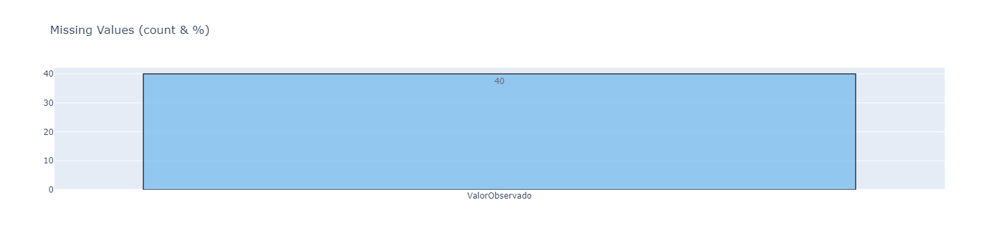

In [24]:
ideam = pd.DataFrame({'ValorObservado': [1,None, 3, None, 5]})
missing_plot(ideam, 'ValorObservado')